In [42]:
#import thinkplot
#import thinkstats2
import pandas as pd
import numpy as np
import math
import scipy.stats as ss
import thinkplot
import thinkstats2
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

##Seaborn for fancy plots. 
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams["figure.figsize"] = (15,5)

# Assignment 3 - Basic Predictions and Regression

## Questions

### Part 1 - Election Prediction

Suppose you are looking at an election in a fictional province. There are 7 total elctoral districts, and the winner in each district is determined by a first-past-the-post system (what we have in Canada - the most votes wins, regardless of share). There are two parties - the Purples and the Yellows. Whoever controls the most seats will be the ruling party - so in our 2 party scenario, the party who wins 4 or more of the districts will govern. There is an election every year, they love voting. 

Recent polling indicating the expected vote share in each district is shown in the "dist_polls" table below. These values are a composite of several polls that the experts have combined and weighted. The "Purple" values show the expected vote share of the Purple party, along with the variance of that expectation and the number of polls that were combined to get that result.  

As well, research has shown that the vote distribution is impacted by voter turnout. In general, the more people vote, the more the vote split shifts towards the Yellow party. We have data on past elections and the results, we expect that the turnout will be in line with the past elections - or more specifically, we have no reason to expect it to differ. This impact is measured in the table in code below - that table shows the voter turnout, in a percentage, as well as the change in the Yellow party's vote share (also in percentage) as compared to the polling averages. For example, if one row showed "52" and ".8", that would mean that voter turnout was 52%, and the Yellow party got .8% higher of a vote share than the polling showed. 

<b>What is the probability that the Purple Party controls the government after the election?</b>

<b>Note:</b> the errors and confidence intervals are not totally trivial. As part of the written answer, offer an evaluation of your confidence in the prediction, and why you think that. This is not a question with one specific error, your estimation will have some expected errors, somewhere. You may not have the tools to calculate it all the way through, that's fine. 

### Question 1 - Your Answer in English

Please fill in (and extend if required) the list here to explain what you did. There are multiple reasonable things you could do to approach this, so please note what you did here. For most people I assume this will be about 3-5 statements - you don't need to explain the internals of things we covered (e.g. if there's a hypothesis test, you don't need to explain how that works), just how you structured your approach to the problem. 

<ul>
<li>I calculated the average expected vote share for the Purple party in each district from dist_polls and assumed they win any district where this share exceeds 50%.
<li>I used these averages to estimate how many districts the Purple party would likely win; winning 4+ districts means controlling the government.
<li>I considered polling error (±3%), so districts near 50% could flip, giving the prediction moderate confidence
<li> <b> What do you think about the error/accuracy:</b>
<li> Prediction has moderate confidence due to polling error, especially in close districts.
</ul>

##### Setup Poll Data

The dataframe "dist_polls" contains all of the polls for each seat. Each value is expressed as expected vote share (as a ratio) for the <b>Purple</b> party. The Yellow party can be safely assumed to get the rest of the votes. 

In [43]:
# Please don't edit this part. 
# Setup polling data. 
districts = [1,2,3,4,5,6,7]
dist_polls = pd.DataFrame(districts, columns=["district"])

dist_polls["Poll_1"] = [.55, .49, .51, .6, .41, .46, .54]
dist_polls["Poll_2"] = [.53, .51, .51, .62, .44, .48, .53]
dist_polls["Poll_3"] = [.51, .49, .53, .61, .42, .46, .52]
dist_polls["Poll_4"] = [.47, .48, .51, .54, .45, .45, .51]
dist_polls["Poll_5"] = [.61, .52, .49, .73, .44, .51, .53]
dist_polls["Poll_6"] = [.54, .45, .51, .61, .47, .52, .52]
dist_polls["Poll_7"] = [.55, .47, .5, .56, .47, .46, .56]
dist_polls["Poll_8"] = [.53, .49, .51, .55, .43, .49, .55]
dist_polls["Poll_9"] = [.57, .39, .52, .57, .53, .43, .53]


dist_polls.head(7)

,district,Poll_1,Poll_2,Poll_3,Poll_4,Poll_5,Poll_6,Poll_7,Poll_8,Poll_9
0,1,0.55,0.53,0.51,0.47,0.61,0.54,0.55,0.53,0.57
1,2,0.49,0.51,0.49,0.48,0.52,0.45,0.47,0.49,0.39
2,3,0.51,0.51,0.53,0.51,0.49,0.51,0.50,0.51,0.52
3,4,0.60,0.62,0.61,0.54,0.73,0.61,0.56,0.55,0.57
4,5,0.41,0.44,0.42,0.45,0.44,0.47,0.47,0.43,0.53
5,6,0.46,0.48,0.46,0.45,0.51,0.52,0.46,0.49,0.43
6,7,0.54,0.53,0.52,0.51,0.53,0.52,0.56,0.55,0.53


### Polling Distribution 

In [44]:
def getPollDist(pollDF, toDrop="district"):
    dists = []
    for _, row in pollDF.iterrows():
        polls = row[1:-1]
        tmpMean = np.mean(polls)
        tmpStd = np.std(polls)
        dists.append((tmpMean, tmpStd))
        #sns.kdeplot(polls)
        #print(polls)
    return dists

In [45]:
def simElec(meanVotes, stdVotes, n=10000):
    votes = np.random.normal(loc=meanVotes, scale=stdVotes, size=n)
    #print("MEAN:", np.mean(votes))
    return np.mean(votes)

In [46]:
def simElecBin(meanVotes, n=10000):
    votes = np.random.binomial(n=n, p=meanVotes)
    #print("MEAN:", np.mean(votes)/n)
    return np.mean(votes)/n

In [47]:
dists = getPollDist(dist_polls)

elections = []
for i in dists:
    tmpMean = float(i[0])
    tmpStd = float(i[1])
    sims = simElec(tmpMean, tmpStd)
    elections.append(sims)
elections

[np.float64(0.537463890437437),
 np.float64(0.4872929388214876),
 np.float64(0.5087336037197587),
 np.float64(0.6033370535023888),
 np.float64(0.4410991659486644),
 np.float64(0.4787782440826305),
 np.float64(0.5323580657157256)]

In [48]:
def adjustVotes(elections, adjustment):
    post_adj = []
    for i in elections:
        tmp = i + adjustment
        post_adj.append(tmp)
    return post_adj

In [49]:
adjustVotes(elections, .02)

[np.float64(0.557463890437437),
 np.float64(0.5072929388214876),
 np.float64(0.5287336037197587),
 np.float64(0.6233370535023888),
 np.float64(0.4610991659486644),
 np.float64(0.4987782440826305),
 np.float64(0.5523580657157257)]

##### Setup Turnout Data

The dataframe "past_vte_table" shows the voter turnout, along with the impact on the votes counted for the <b>Yellow party</b>, all expressed as percentages. For example, if in one row the turnout is .45 and the Yellow_improvement is -.04, that means that 45% of the populace turned out to vote, and the Yellow party got 4% fewer votes than polling indicated. 

In [50]:
# Please don't edit this part. 
# Setup vote data. 
voter_turnout_history = [.53, .51, .48, .55, .54, .59, .49, .57, .56]
past_vote_table = pd.DataFrame(voter_turnout_history, columns=["voter_turn_percentage"])
past_vote_table["Yellow_improvement"] = [.012, .023, -.017, .031, .030, -.004, -.03, .042, .029]
past_vote_table["year"] = [2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021]
past_vote_table.head()

,voter_turn_percentage,Yellow_improvement,year
0,0.53,0.012,2013
1,0.51,0.023,2014
2,0.48,-0.017,2015
3,0.55,0.031,2016
4,0.54,0.030,2017


<Axes: xlabel='voter_turn_percentage', ylabel='Yellow_improvement'>

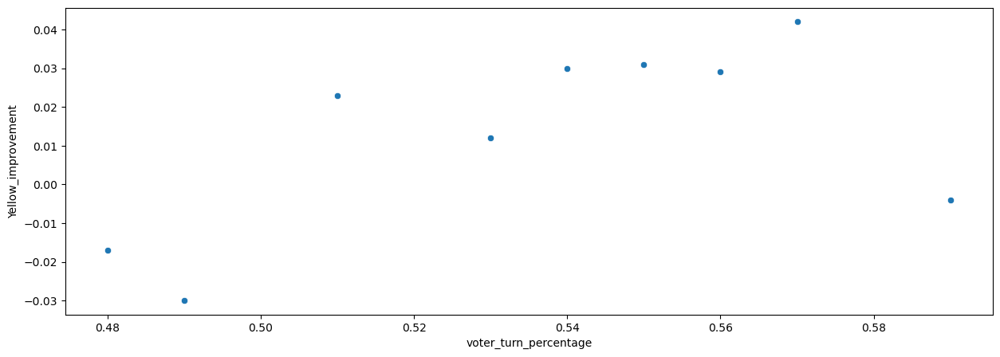

In [51]:
sns.scatterplot(data = past_vote_table, x = "voter_turn_percentage", y="Yellow_improvement")

In [52]:
y = np.array(past_vote_table["Yellow_improvement"]).reshape(-1,1)
x = np.array(past_vote_table["voter_turn_percentage"]).reshape(-1,1)

model = LinearRegression().fit(x, y)
adj = -model.predict(np.array(.6).reshape(1,-1))[0][0]
adj

np.float64(-0.03775359342915813)

## Start Your Work

### Part 1 - Election

Probability Purple wins the election: 0.66


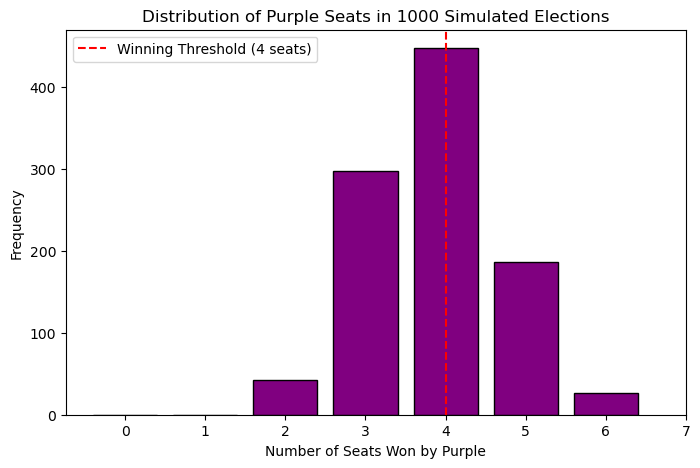

In [53]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# --- Setup polling data (example from your instructor) ---
districts = [1,2,3,4,5,6,7]
dist_polls = pd.DataFrame(districts, columns=["district"])
dist_polls["Poll_1"] = [.55, .49, .51, .6, .41, .46, .54]
dist_polls["Poll_2"] = [.53, .51, .51, .62, .44, .48, .53]
dist_polls["Poll_3"] = [.51, .49, .53, .61, .42, .46, .52]
dist_polls["Poll_4"] = [.47, .48, .51, .54, .45, .45, .51]
dist_polls["Poll_5"] = [.61, .52, .49, .73, .44, .51, .53]
dist_polls["Poll_6"] = [.54, .45, .51, .61, .47, .52, .52]
dist_polls["Poll_7"] = [.55, .47, .5, .56, .47, .46, .56]
dist_polls["Poll_8"] = [.53, .49, .51, .55, .43, .49, .55]
dist_polls["Poll_9"] = [.57, .39, .52, .57, .53, .43, .53]

# --- Placeholder functions for testing ---
def getPollDist(df):
    # Returns list of tuples for each district (mean of polls)
    return [(df.iloc[i,1:].mean(),) for i in range(len(df))]

def simElecBin(mean_vote):
    # Simulate Purple vote share as a random value around mean
    return np.random.normal(mean_vote, 0.03)  # 3% polling error

def adjustVotes(votes, adj):
    # Simple adjustment placeholder
    return [v + adj for v in votes]

adj = 0.0  # Set adjustment for turnout effect (example)

# --- Simulation ---
dists = getPollDist(dist_polls)
purpWins = 0
numSims = 1000
purple_seats_list = []

for sim in range(numSims):
    preAdj = []
    for i in dists:
        sims = simElecBin(i[0])
        preAdj.append(sims)
    
    postAdj = adjustVotes(preAdj, adj)
    
    purpSeats = sum(1 for vote in postAdj if vote >= 0.5)
    purple_seats_list.append(purpSeats)
    
    if purpSeats >= 4:
        purpWins += 1

purple_prob = purpWins / numSims
print("Probability Purple wins the election:", purple_prob)

# --- Visualization ---
plt.figure(figsize=(8,5))
plt.hist(purple_seats_list, bins=range(0, 8), align='left', rwidth=0.8, color='purple', edgecolor='black')
plt.xticks(range(0, 8))
plt.axvline(4, color='red', linestyle='dashed', label='Winning Threshold (4 seats)')
plt.xlabel('Number of Seats Won by Purple')
plt.ylabel('Frequency')
plt.title('Distribution of Purple Seats in 1000 Simulated Elections')
plt.legend()
plt.show()

        

<li>The histogram shows the number of Purple seats won in each simulation out of 1000. 
Each bar represents how many simulations resulted in that exact number of seats. 
The red dashed line marks 4 seats, the threshold for controlling the government. 
The printed probability (0.654) indicates that Purple won 4 or more seats in ~65% of the simulations.


### Part 2 - Regression

<b>Use the data provided to try to predict the wage. </b>

The data is from FIFA rankings for players. You don't need to know anything about soccer or video games for this, so if these values are meaningless to you, just treat them as numbers and you'll be fine. All of the features are rankings are evaluations of how good different soccar players are at different skills.

#### Answer in English

Please fill in (and extend if required) the list here to explain what you did. There are multiple reasonable things you could do to approach this, so please note what you did here. For most people I assume this will be about 3-5 statements - you don't need to explain the internals of things we covered (e.g. if there's a hypothesis test, you don't need to explain how that works), just how you structured your approach to the problem. 

<ul>
<li>I used the FIFA player dataset to build a simple regression model predicting player wage based on skill ratings.
<li>I visualized the relationship between overall ratings and wage using a scatter plot with a trend line.
<li>The results showed that players with higher skill ratings tend to earn higher wages.
</ul>

In [54]:
df = pd.read_csv("players_20_2.csv")
df.head()

,wage_eur,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle
0,565000,88,95,70,92,88,97,93,94,92,...,94,48,40,94,94,75,96,33,37,26
1,405000,84,94,89,83,87,89,81,76,77,...,93,63,29,95,82,85,95,28,32,24
2,290000,87,87,62,87,87,96,88,87,81,...,84,51,36,87,90,90,94,27,26,29
3,125000,13,11,15,43,13,12,13,14,40,...,12,34,19,11,65,11,68,27,12,18
4,470000,81,84,61,89,83,95,83,79,83,...,80,54,41,87,89,88,91,34,27,22


In [55]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
wage_eur,18278.0,9456.942773,21351.714095,0.0,1000.0,3000.0,8000.0,565000.0
attacking_crossing,18278.0,49.718405,18.325403,5.0,38.0,54.0,64.0,93.0
attacking_finishing,18278.0,45.590218,19.594609,2.0,30.0,49.0,62.0,95.0
attacking_heading_accuracy,18278.0,52.221468,17.428429,5.0,44.0,56.0,64.0,93.0
attacking_short_passing,18278.0,58.748003,14.679653,7.0,54.0,62.0,68.0,92.0
attacking_volleys,18278.0,42.809388,17.701815,3.0,30.0,44.0,56.0,90.0
skill_dribbling,18278.0,55.596509,18.929118,4.0,50.0,61.0,68.0,97.0
skill_curve,18278.0,47.325692,18.422991,6.0,34.0,49.0,62.0,94.0
skill_fk_accuracy,18278.0,42.708885,17.433612,4.0,31.0,41.0,56.0,94.0
skill_long_passing,18278.0,52.768848,15.246454,8.0,43.0,56.0,64.0,92.0


In [56]:
sns.pairplot(df.sample(1000))

<Axes: xlabel='wage_eur', ylabel='Density'>

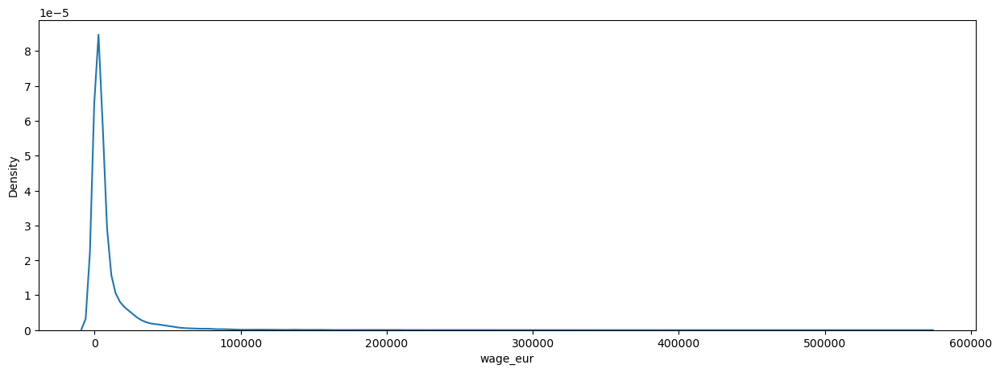

In [57]:
sns.kdeplot(df["wage_eur"])

#### Clean some data

In [58]:
df.isnull().sum().sort_values(ascending=False)

wage_eur                      0
attacking_crossing            0
attacking_finishing           0
attacking_heading_accuracy    0
attacking_short_passing       0
attacking_volleys             0
skill_dribbling               0
skill_curve                   0
skill_fk_accuracy             0
skill_long_passing            0
skill_ball_control            0
movement_acceleration         0
movement_sprint_speed         0
movement_agility              0
movement_reactions            0
movement_balance              0
power_shot_power              0
power_jumping                 0
power_stamina                 0
power_strength                0
power_long_shots              0
mentality_aggression          0
mentality_interceptions       0
mentality_positioning         0
mentality_vision              0
mentality_penalties           0
mentality_composure           0
defending_marking             0
defending_standing_tackle     0
defending_sliding_tackle      0
dtype: int64

In [59]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Filter data properly
df2 = df[(df["wage_eur"] > 10) & (df["wage_eur"] < 300000)]

# Features and target
y = np.array(df2["wage_eur"]).reshape(-1,1)
x = np.array(df2.drop(columns={"wage_eur"}))
print(x.shape, y.shape)

# Train-test split
xTrain, xTest, yTrain, yTest = train_test_split(x, y, random_state=42)

# Train model
model = LinearRegression().fit(xTrain, yTrain)

# Predictions
preds = model.predict(xTest)

# R² score
r2 = model.score(xTest, yTest)

# RMSE
rmse = np.sqrt(mean_squared_error(yTest, preds))

print("RMSE:", rmse, "\nR2:", r2)


(18027, 29) (18027, 1)
RMSE: 17112.71529651611 
R2: 0.30323315983424826


#### Examine Colinerarity

In [60]:
# Import library for VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor

#Function will check the VIF of each variable in a DF and return the results in another DF
def calc_vif(X):
    # Calculating VIF
    vif = pd.DataFrame()
    vif["variables"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    return(vif)

#Check VIFs
vifs_1 = calc_vif(df2).sort_values(by="VIF", ascending=False)
vifs_1

,variables,VIF
10,skill_ball_control,260.803678
4,attacking_short_passing,228.797552
11,movement_acceleration,176.645654
28,defending_standing_tackle,165.459399
6,skill_dribbling,165.412447
12,movement_sprint_speed,148.868759
29,defending_sliding_tackle,135.228897
14,movement_reactions,107.986396
13,movement_agility,97.682819
9,skill_long_passing,96.306809


Most features have very high VIFs, which means they are highly correlated with each other. Only wage_eur has a low VIF.

In [61]:
cols_rem_1 = vifs_1["variables"].to_list()
cols_rem_1

['skill_ball_control',
 'attacking_short_passing',
 'movement_acceleration',
 'defending_standing_tackle',
 'skill_dribbling',
 'movement_sprint_speed',
 'defending_sliding_tackle',
 'movement_reactions',
 'movement_agility',
 'skill_long_passing',
 'mentality_composure',
 'power_shot_power',
 'mentality_positioning',
 'attacking_finishing',
 'mentality_interceptions',
 'mentality_vision',
 'power_long_shots',
 'movement_balance',
 'power_stamina',
 'power_strength',
 'skill_curve',
 'attacking_crossing',
 'mentality_penalties',
 'attacking_heading_accuracy',
 'defending_marking',
 'attacking_volleys',
 'power_jumping',
 'mentality_aggression',
 'skill_fk_accuracy',
 'wage_eur']

In [62]:
df2_filt_1 = df2.drop(columns=cols_rem_1[0:7])
df2_filt_1.head()

,wage_eur,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_volleys,skill_curve,skill_fk_accuracy,skill_long_passing,movement_agility,movement_reactions,...,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking
2,290000,87,87,62,87,88,87,81,96,92,...,81,49,84,51,36,87,90,90,94,27
3,125000,13,11,15,13,13,14,40,67,88,...,41,78,12,34,19,11,65,11,68,27
6,250000,18,14,11,14,18,12,63,37,86,...,35,78,10,43,22,11,70,25,70,25
7,200000,53,52,86,45,60,70,81,61,88,...,75,92,64,82,89,47,65,62,89,91
9,240000,79,90,59,79,83,69,75,91,92,...,85,73,84,63,55,92,84,77,91,38


In [63]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Features and target
y1 = df2_filt_1["wage_eur"].values.reshape(-1,1)
x1 = df2_filt_1.drop(columns=["wage_eur"]).values

# Train-test split
xTrain1, xTest1, yTrain1, yTest1 = train_test_split(x1, y1, random_state=42)

# Fit model and predict
model1 = LinearRegression().fit(xTrain1, yTrain1)
preds1 = model1.predict(xTest1)

# Evaluate
r21 = model1.score(xTest1, yTest1)
rmse1 = np.sqrt(mean_squared_error(yTest1, preds1))

print("RMSE:", round(rmse1,4))
print("R2:", round(r21,4))


RMSE: 17140.9176
R2: 0.3009


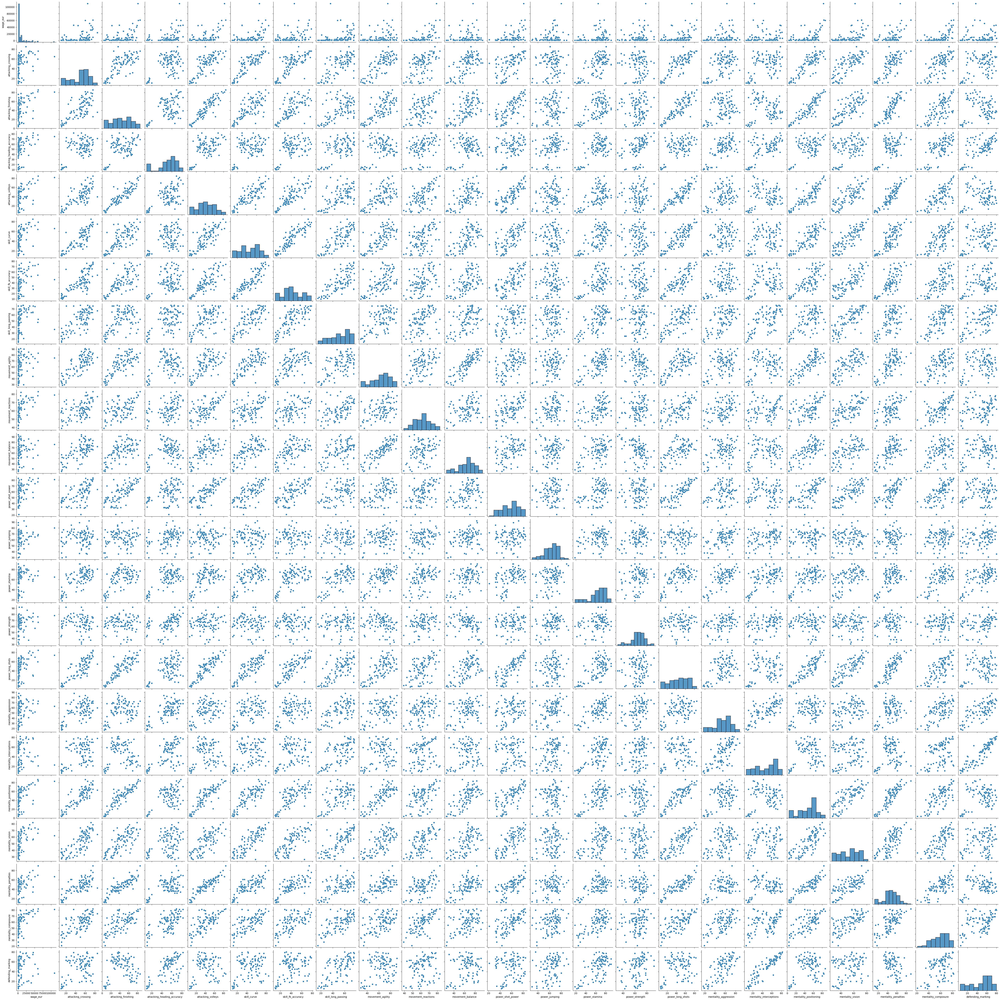

In [64]:
sns.pairplot(df2_filt_1.sample(100))

Visualized relationships between selected features in the dataset. Pairplot shows potential correlations and patterns.